In [2]:
library(Seurat)
library(ggplot2)
library(wesanderson)
library(ggcorrplot)
library(ggpubr)
library(tidyverse)
library(geneBasisR)

Attaching SeuratObject

Attaching sp

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ tibble  3.1.8      ✔ dplyr   1.0.10
✔ tidyr   1.2.1      ✔ stringr 1.4.1 
✔ readr   2.1.2      ✔ forcats 0.5.2 
✔ purrr   0.3.4      
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


In [2]:
source('../00_preprocessing/preprocessing.R')

Loading required package: SummarizedExperiment

Loading required package: MatrixGenerics

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package:dplyr’:

    count



Attaching package: ‘MatrixGenerics’


The following objects are masked from ‘package:matrixStats’:

    colAlls, colAnyNAs, colAnys, colAvgsPerRowSet, colCollapse,
    colCounts, colCummaxs, colCummins, colCumprods, colCumsums,
    colDiffs, colIQRDiffs, colIQRs, colLogSumExps, colMadDiffs,
    colMads, colMaxs, colMeans2, colMedians, colMins, colOrderStats,
    colProds, colQuantiles, colRanges, colRanks, colSdDiffs, colSds,
    colSums2, colTabulates, colVarDiffs, colVars, colWeightedMads,
    colWeightedMeans, colWeightedMedians, colWeightedSds,
    colWeightedVars, rowAlls, rowAnyNAs, rowAnys, rowAvgsPerColSet,
    rowCollapse, rowCounts, rowCummaxs, rowCummins, rowCumprods,
    rowCumsums, rowDiffs, rowIQRDiffs, rowIQRs, rowLogSumExps,
    rowMadDiffs, 

In [5]:
obj = qs::qread('_targets/objects/exp_ngo_all_40k')

In [3]:
obj_neurons = qs::qread('_targets/objects/exp_labelled_neuron_ngo_40k')
obj_other = qs::qread('_targets/objects/exp_labelled_other')

In [4]:
obj

An object of class Seurat 
37432 features across 40000 samples within 2 assays 
Active assay: SCT (18074 features, 3000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [5]:
genes_100_all_40k = qs::qread('_targets/objects/genes_100_all_40k')

In [157]:
genes_stat_3rd = qs::qread('_targets/objects/genes_stat_3rd_all_40k.10__other.70__neuron_40k.20__sw')
genes_100_all_40k_pre5ea = genes_stat_3rd$gene

In [168]:
intersect(genes_100_all_40k_pre5ea, genes_100_all_40k) %>% length

[1] 55

In [6]:
obj_100g = subset_seurat_obj_genes(obj, genes_100_all_40k) %>% sc_transform_fgf1
obj_100g

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 40000

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  4.84

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 6.058872 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
Warning message:
"The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session"
14:12:08 UMAP embedding parameters a = 0.9922 b = 1.112

14:12:08 Read 40000 rows and found 30 numeric columns

14:12:08 Using Annoy for neighbor search

An object of class Seurat 
200 features across 40000 samples within 2 assays 
Active assay: SCT (100 features, 100 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [16]:
obj_neurons_100g = subset_seurat_obj_genes(obj_neurons, genes_100_all_40k) %>% sc_transform_fgf1
obj_neurons_100g

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 40000

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Found 1 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  6.76

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 4.990093 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
14:32:09 UMAP embedding parameters a = 0.9922 b = 1.112

14:32:09 Read 40000 rows and found 30 numeric columns

14:32:09 Using Annoy for neighbor search, n_neighbors = 30

14:32:09 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

An object of class Seurat 
200 features across 40000 samples within 2 assays 
Active assay: SCT (100 features, 100 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [17]:
obj_other_100g = subset_seurat_obj_genes(obj_other, genes_100_all_40k) %>% sc_transform_fgf1
obj_other_100g

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 37179

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  1

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 5.317661 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
14:34:25 UMAP embedding parameters a = 0.9922 b = 1.112

14:34:25 Read 37179 rows and found 30 numeric columns

14:34:25 Using Annoy for neighbor search, n_neighbors = 30

14:34:25 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

An object of class Seurat 
200 features across 37179 samples within 2 assays 
Active assay: SCT (100 features, 100 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [158]:
obj_100g_pre5ea = subset_seurat_obj_genes(obj, genes_100_all_40k_pre5ea) %>% sc_transform_fgf1
obj_100g_pre5ea

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 40000

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  7.84

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 6.789578 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
17:04:37 UMAP embedding parameters a = 0.9922 b = 1.112

17:04:37 Read 40000 rows and found 30 numeric columns

17:04:37 Using Annoy for neighbor search, n_neighbors = 30

17:04:37 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

An object of class Seurat 
200 features across 40000 samples within 2 assays 
Active assay: SCT (100 features, 100 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [159]:
obj_neurons_100g_pre5ea = subset_seurat_obj_genes(obj_neurons, genes_100_all_40k_pre5ea) %>% sc_transform_fgf1
obj_neurons_100g_pre5ea

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 40000

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  11.56

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 6.367754 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
17:07:32 UMAP embedding parameters a = 0.9922 b = 1.112

17:07:32 Read 40000 rows and found 30 numeric columns

17:07:32 Using Annoy for neighbor search, n_neighbors = 30

17:07:32 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

An object of class Seurat 
200 features across 40000 samples within 2 assays 
Active assay: SCT (100 features, 100 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [160]:
obj_other_100g_pre5ea = subset_seurat_obj_genes(obj_other, genes_100_all_40k_pre5ea) %>% sc_transform_fgf1
obj_other_100g_pre5ea

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 37179

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  1.44

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 5.152832 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
17:09:45 UMAP embedding parameters a = 0.9922 b = 1.112

17:09:45 Read 37179 rows and found 30 numeric columns

17:09:45 Using Annoy for neighbor search, n_neighbors = 30

17:09:45 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

An object of class Seurat 
200 features across 37179 samples within 2 assays 
Active assay: SCT (100 features, 100 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

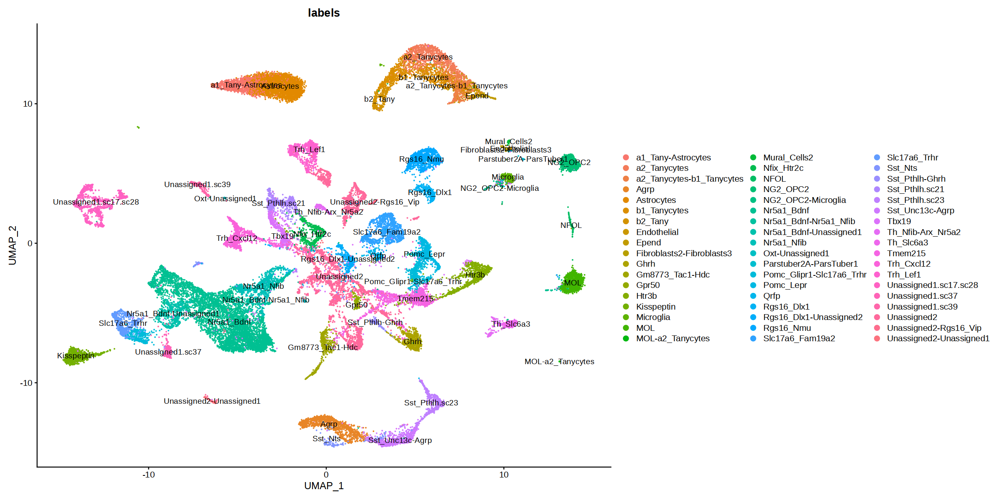

In [10]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj, reduction = "umap", group.by = "labels", label = TRUE)

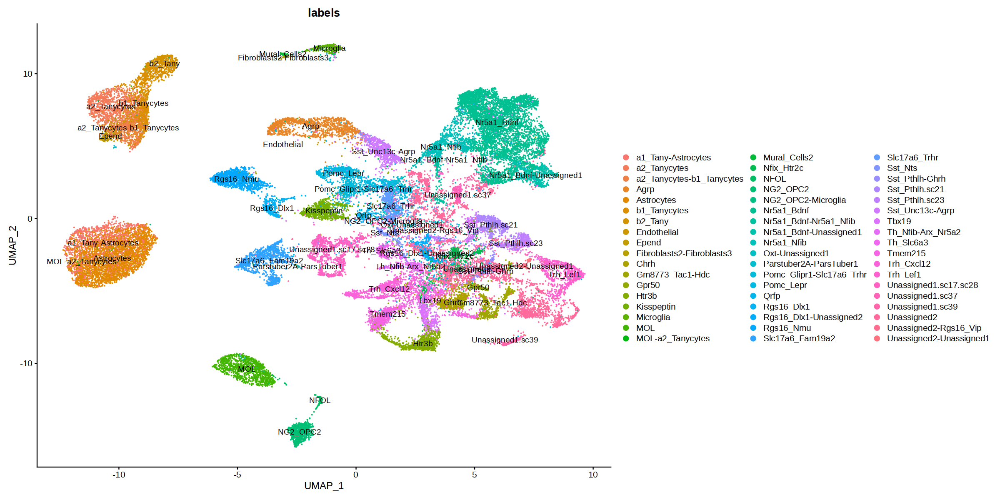

In [7]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_100g, reduction = "umap", group.by = "labels", label = TRUE)

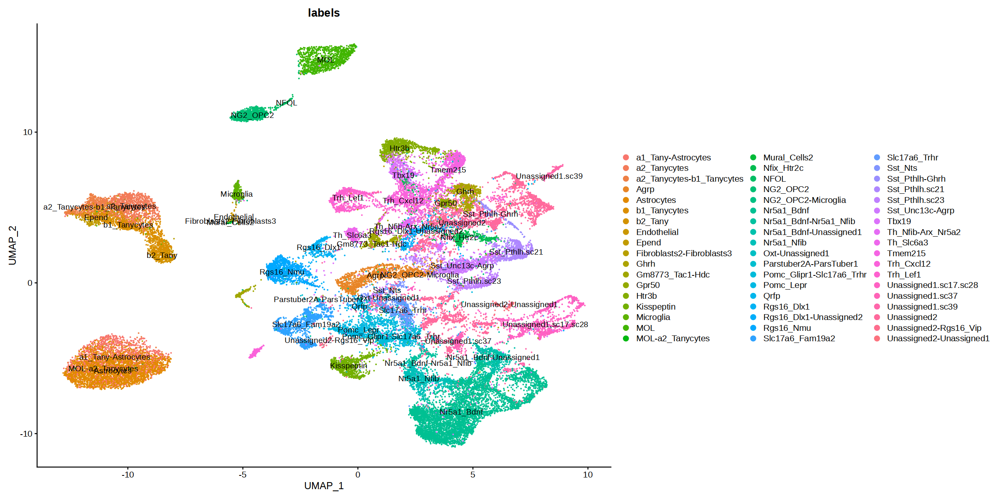

In [161]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_100g_pre5ea, reduction = "umap", group.by = "labels", label = TRUE)

In [21]:
#neurons

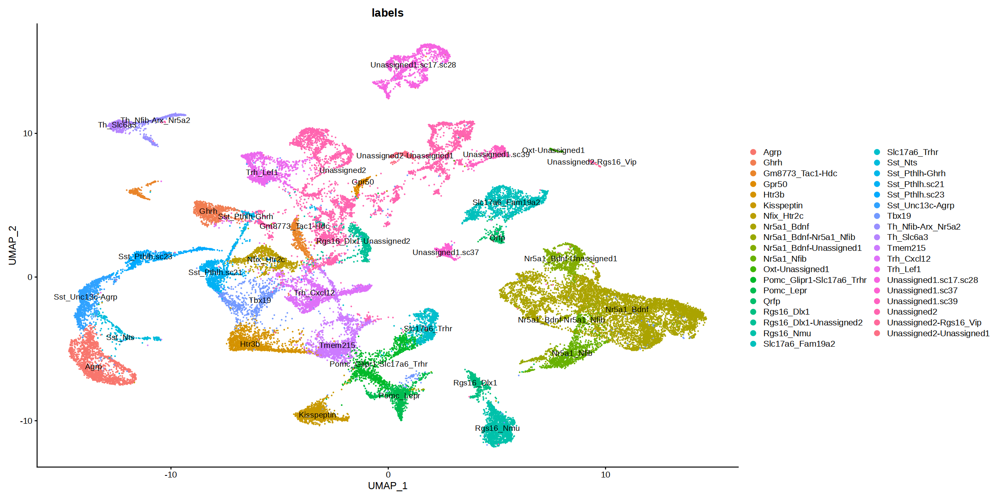

In [22]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_neurons, reduction = "umap", group.by = "labels", label = TRUE)

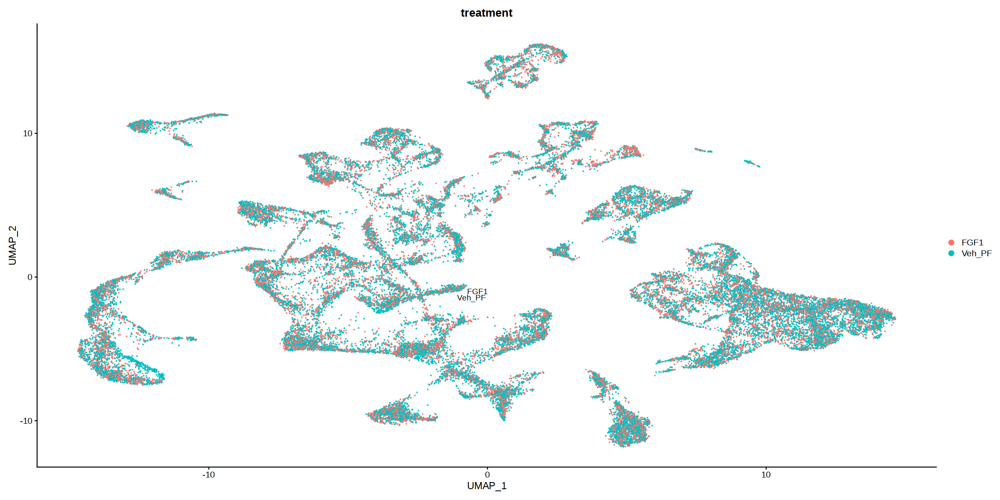

In [173]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_neurons, reduction = "umap", group.by = "treatment", label = TRUE)

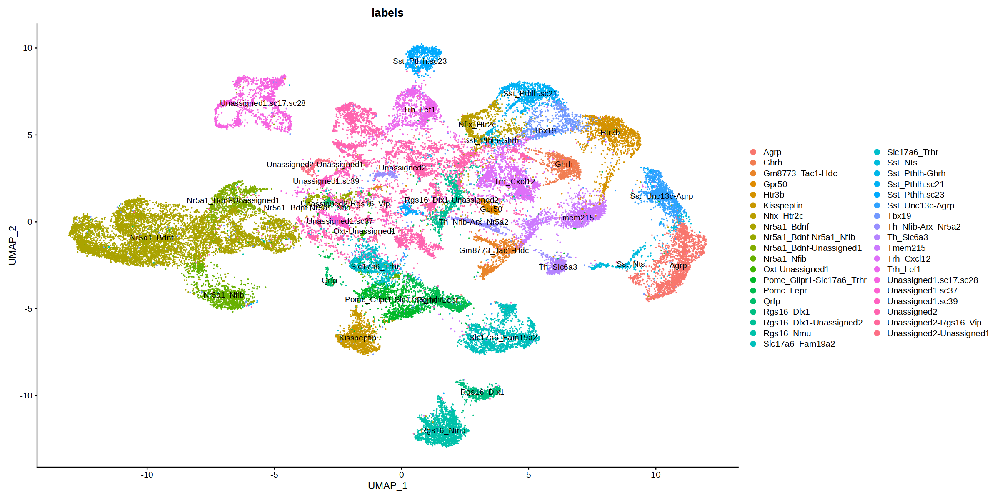

In [24]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_neurons_100g, reduction = "umap", group.by = "labels", label = TRUE)

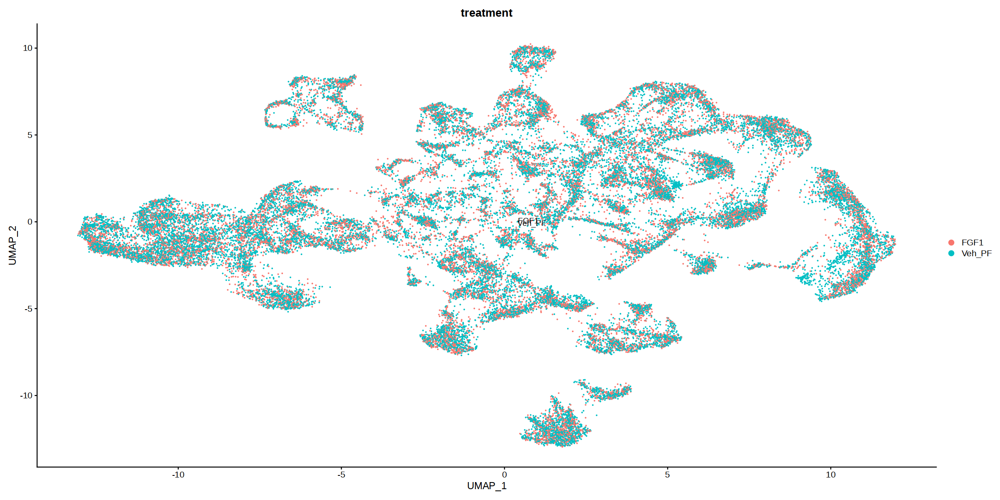

In [172]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_neurons_100g, reduction = "umap", group.by = "treatment", label = TRUE)

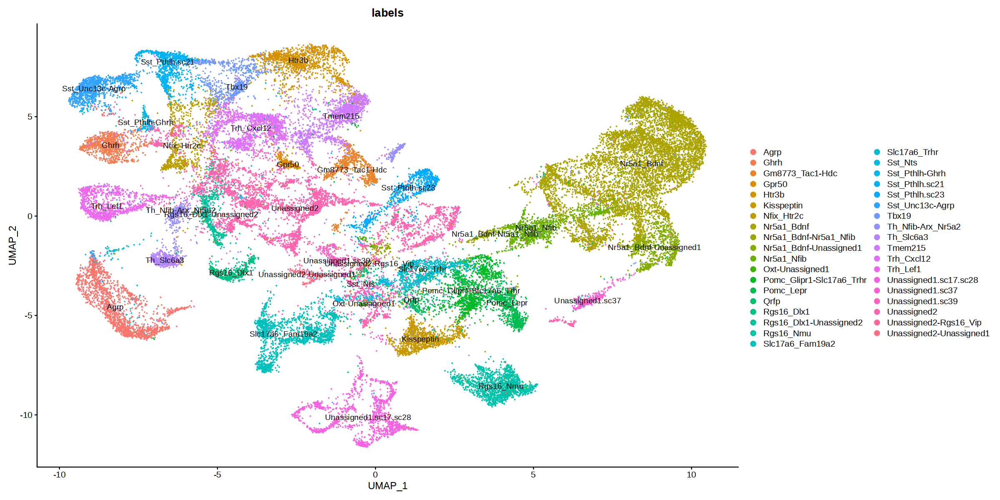

In [167]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_neurons_100g_pre5ea, reduction = "umap", group.by = "labels", label = TRUE)

In [25]:
#other

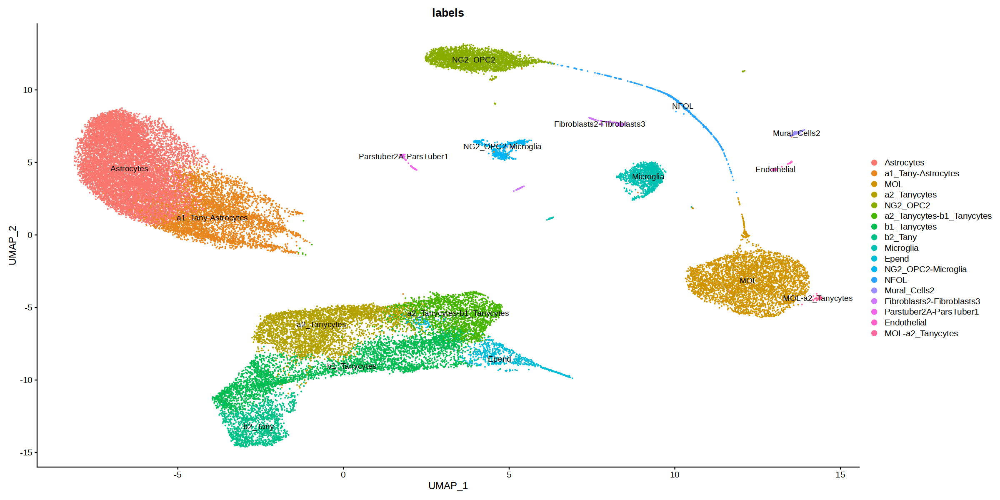

In [26]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_other, reduction = "umap", group.by = "labels", label = TRUE)

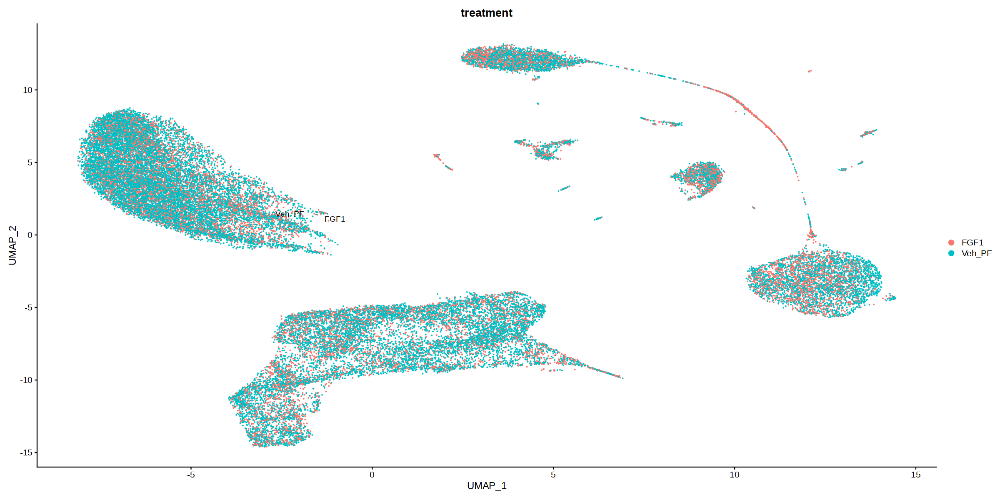

In [171]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_other, reduction = "umap", group.by = "treatment", label = TRUE)

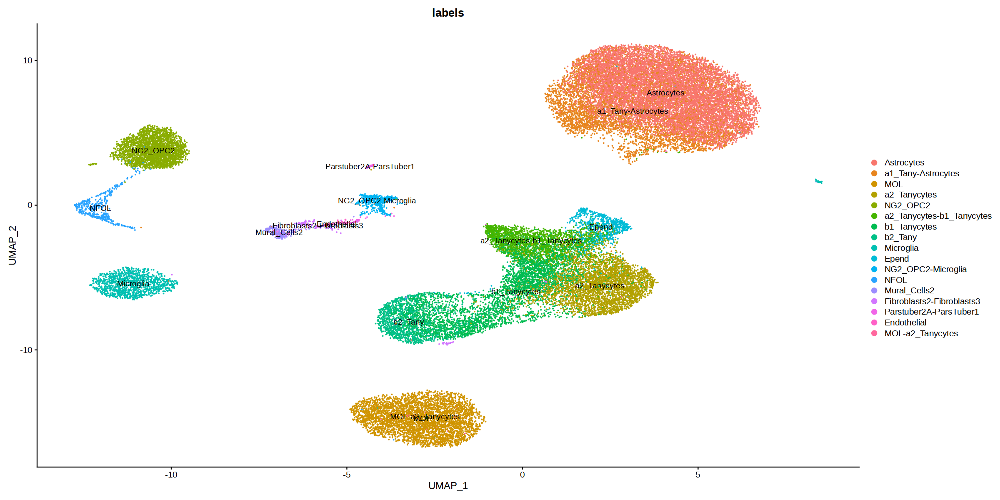

In [27]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_other_100g, reduction = "umap", group.by = "labels", label = TRUE)

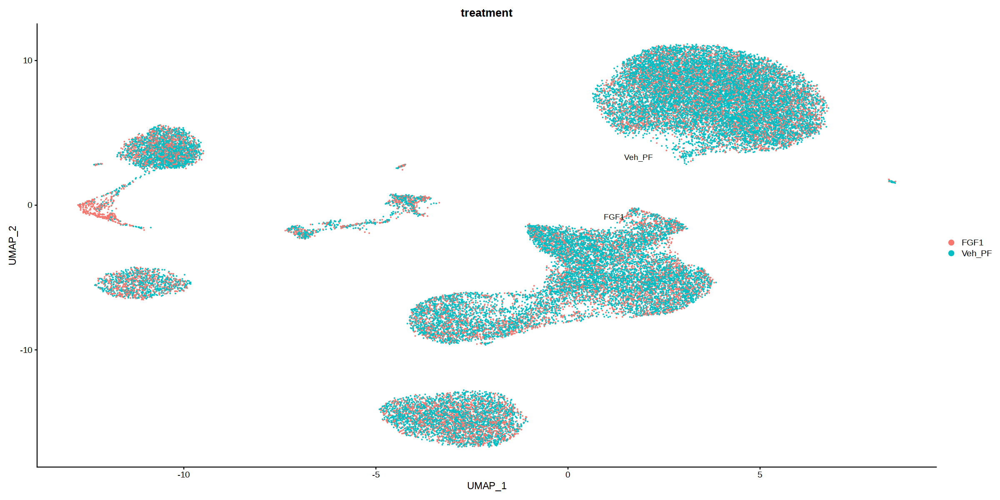

In [170]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_other_100g, reduction = "umap", group.by = "treatment", label = TRUE)

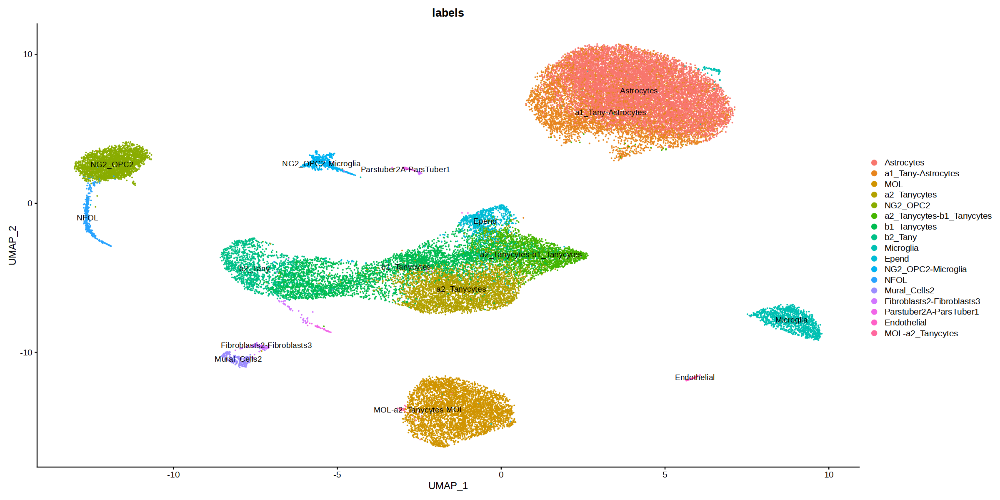

In [163]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_other_100g_pre5ea, reduction = "umap", group.by = "labels", label = TRUE)

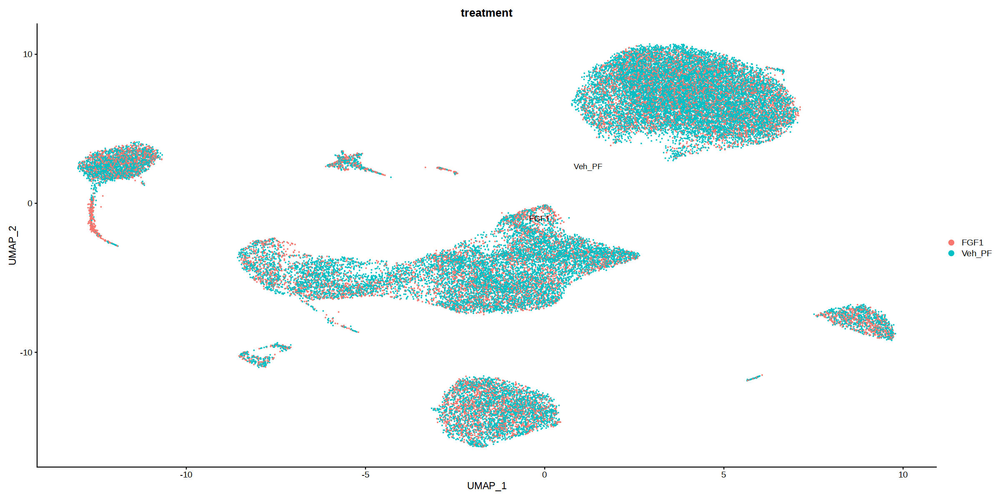

In [169]:
options(repr.plot.width=20, repr.plot.height=10)
DimPlot(obj_other_100g_pre5ea, reduction = "umap", group.by = "treatment", label = TRUE)

In [46]:
plot_pfsub = function(obj, subc){
    obj@meta.data = obj@meta.data %>% mutate(pf = case_when(str_detect(obj@meta.data$polar_label, fixed(subc)) ~ polar_label,
                                                            TRUE ~ 'other'))
    p = DimPlot(obj, reduction = "umap", group.by = "pf", label = TRUE)
    p
}

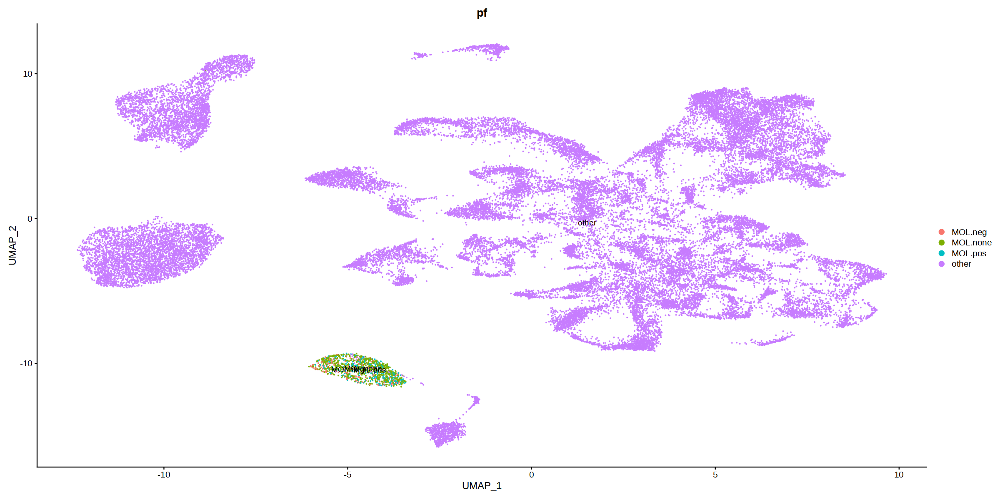

In [63]:
subc = 'MOL.'
obj_100g@meta.data = obj_100g@meta.data %>% mutate(pf = case_when(str_detect(polar_label, fixed(subc)) ~ polar_label,
                                                        TRUE ~ 'other'))
p = DimPlot(obj_100g, reduction = "umap", group.by = "pf", label = TRUE)
p

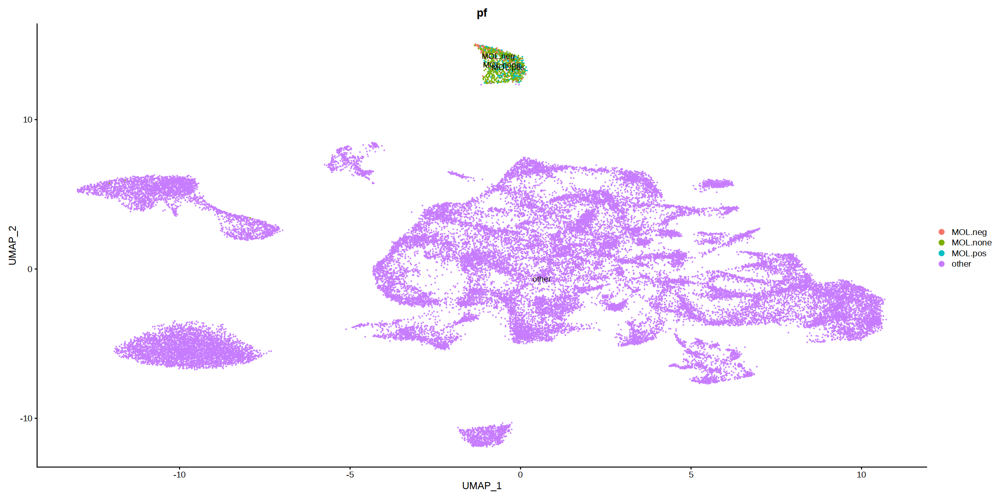

In [64]:
subc = 'MOL.'
obj_100g_pre5ea@meta.data = obj_100g_pre5ea@meta.data %>% mutate(pf = case_when(str_detect(polar_label, fixed(subc)) ~ polar_label,
                                                        TRUE ~ 'other'))
p = DimPlot(obj_100g_pre5ea, reduction = "umap", group.by = "pf", label = TRUE)
p

In [76]:
selected_barcodes = obj %>% subset(subset = labels == 'Astrocytes') %>% `[[` %>% rownames
obj_other_100g_pre5ea_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k_pre5ea) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 99

Excluding 1 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 3038

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 99 genes, 3038 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 1

Calling offset model for all 1 poisson genes

Found 2 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 1 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.36

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.582243 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:15:08 UMAP embedding parameters a = 0.9922 b = 1.112

15:15:08 Read 3038 rows and found 30 numeric columns

15:15:08 Using Annoy for neighbor search, n_neighbors = 30

15:15:08 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*


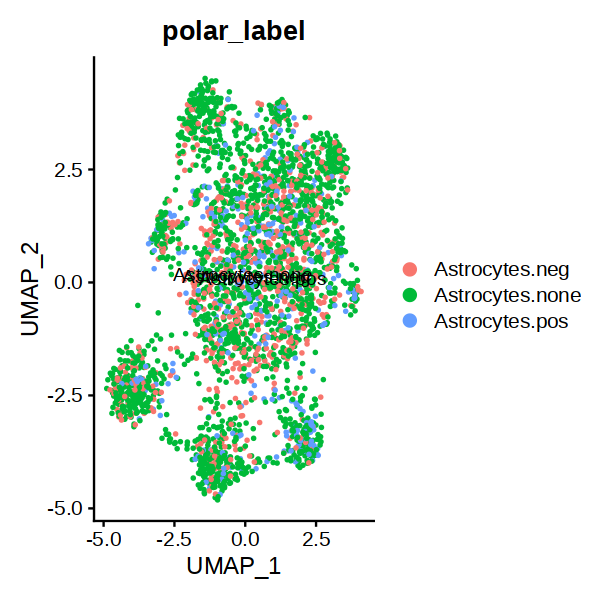

In [77]:
options(repr.plot.width=5, repr.plot.height=5)
p = DimPlot(obj_other_100g_pre5ea_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [94]:
selected_barcodes = obj %>% subset(subset = labels == 'a2_Tanycytes') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 97

Total overdispersed genes: 94

Excluding 3 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 97 by 1041

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 94 genes, 1041 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 3

Calling offset model for all 3 poisson genes

Ignoring theta inf genes

Replacing fit params for 3 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.64

Second step: Get residuals using fitted parameters for 97 genes



  |======================================================================| 100%


Computing corrected count matrix for 97 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.562528 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:25:57 UMAP embedding parameters a = 0.9922 b = 1.112

15:25:57 Read 1041 rows and found 30 numeric columns

15:25:57 Using Annoy for neighbor search, n_neighbors = 30

15:25:57 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*


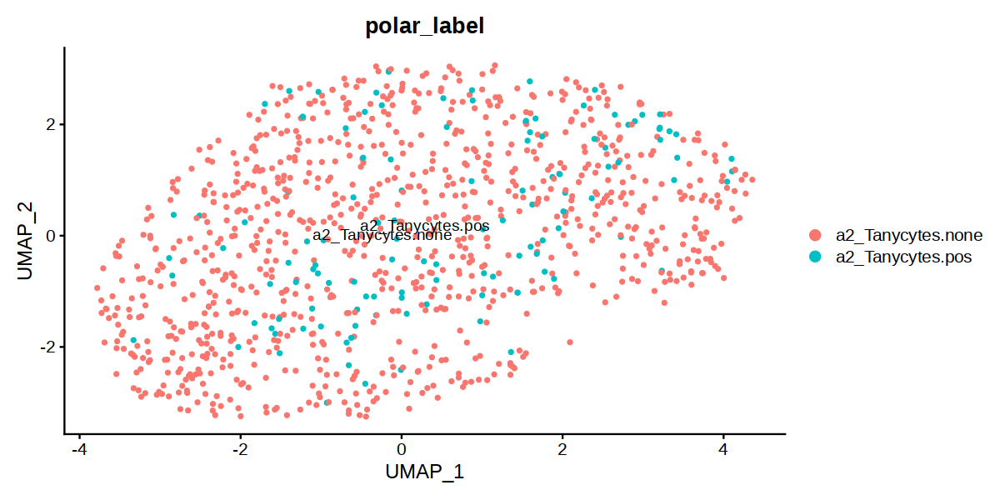

In [95]:
options(repr.plot.width=10, repr.plot.height=5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 99

Total overdispersed genes: 98

Excluding 1 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 99 by 948

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 98 genes, 948 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 1

Calling offset model for all 1 poisson genes

Ignoring theta inf genes

Replacing fit params for 1 poisson genes by theta=Inf

Setting min_variance based on median UMI:  4

Second step: Get residuals using fitted parameters for 99 genes



  |======================================================================| 100%


Computing corrected count matrix for 99 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.534724 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:27:03 UMAP embedding parameters a = 0.9922 b = 1.112

15:27:03 Read 948 rows and found 30 numeric columns

15:27:03 Using Annoy for neighbor search, n_neighbors = 30

15:27:03 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

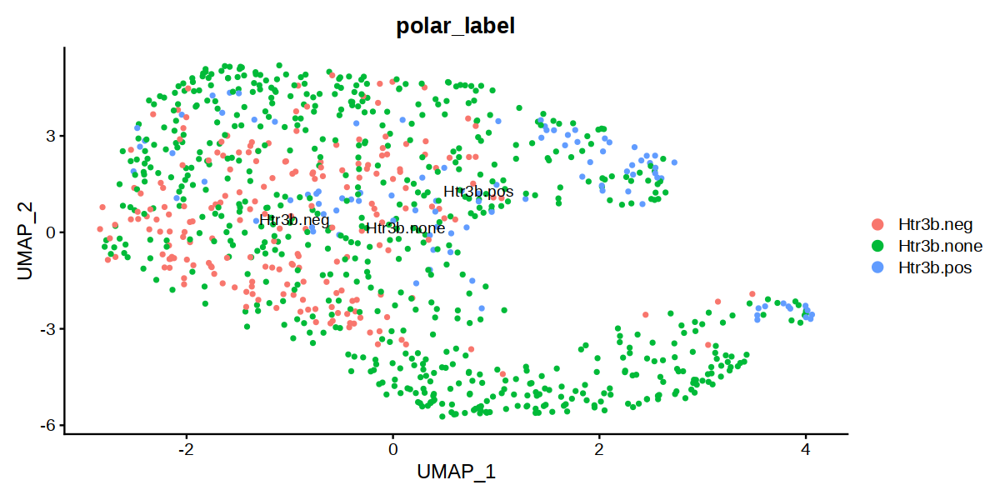

In [96]:
selected_barcodes = obj %>% subset(subset = labels == 'Htr3b') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k) %>% 
sc_transform_fgf1


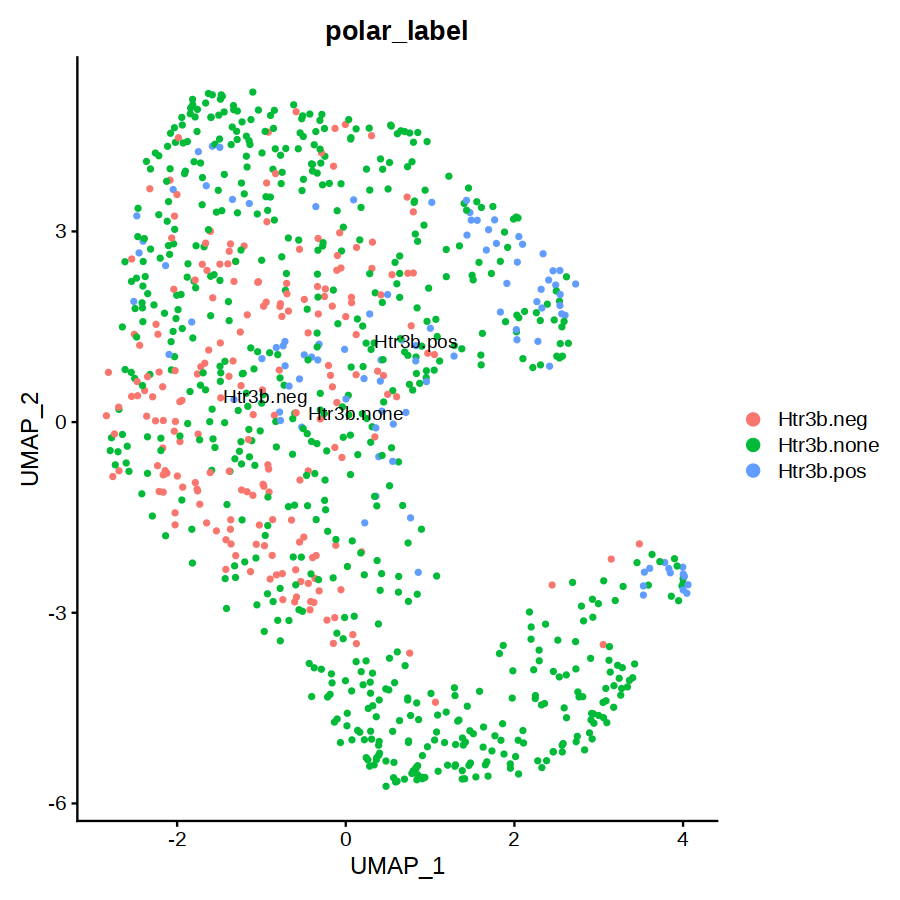

In [99]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [104]:
selected_barcodes = obj %>% subset(subset = labels == 'Htr3b') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k_pre5ea) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 99

Excluding 1 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 948

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 99 genes, 948 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 1

Calling offset model for all 1 poisson genes

Ignoring theta inf genes

Replacing fit params for 1 poisson genes by theta=Inf

Setting min_variance based on median UMI:  1

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.692809 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:30:34 UMAP embedding parameters a = 0.9922 b = 1.112

15:30:34 Read 948 rows and found 30 numeric columns

15:30:34 Using Annoy for neighbor search, n_neighbors = 30

15:30:34 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

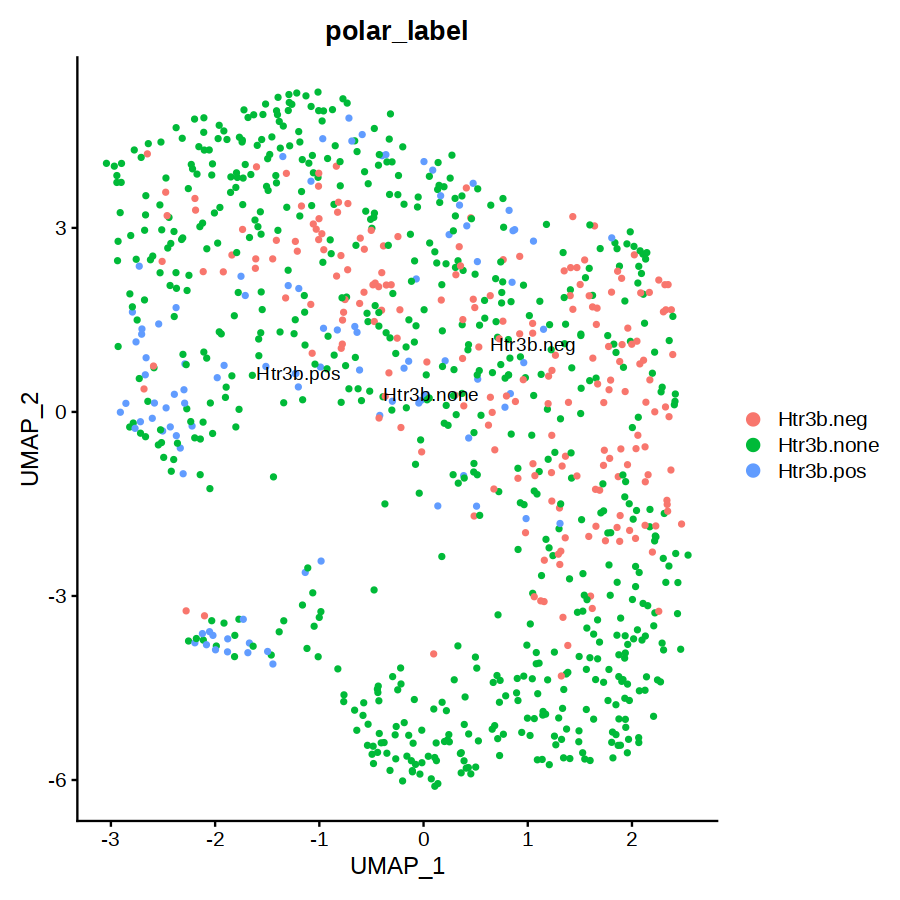

In [105]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [100]:
selected_barcodes = obj %>% subset(subset = labels == 'Agrp') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 1266

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 1266 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  3.24

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.104416 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:27:59 UMAP embedding parameters a = 0.9922 b = 1.112

15:27:59 Read 1266 rows and found 30 numeric columns

15:27:59 Using Annoy for neighbor search, n_neighbors = 30

15:27:59 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*


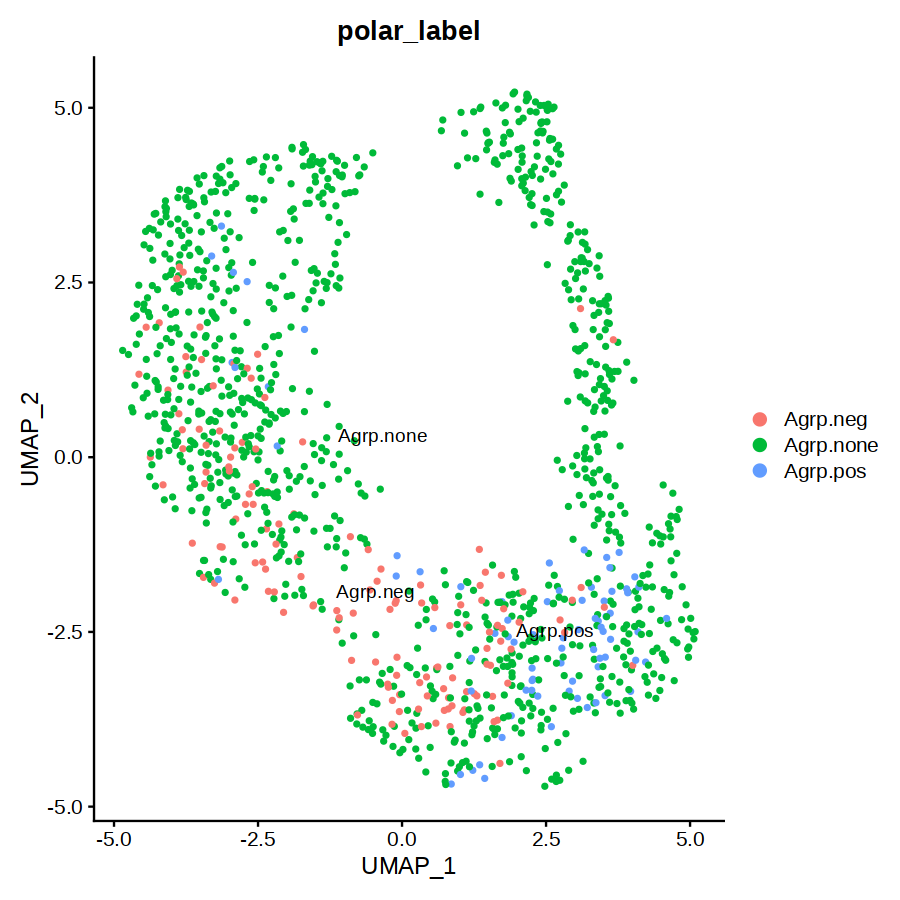

In [101]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [102]:
selected_barcodes = obj %>% subset(subset = labels == 'Agrp') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k_pre5ea) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 100

Excluding 0 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 1266

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 100 genes, 1266 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 0

Calling offset model for all 0 poisson genes

Ignoring theta inf genes

Replacing fit params for 0 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.64

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.186394 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:29:37 UMAP embedding parameters a = 0.9922 b = 1.112

15:29:37 Read 1266 rows and found 30 numeric columns

15:29:37 Using Annoy for neighbor search, n_neighbors = 30

15:29:37 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*


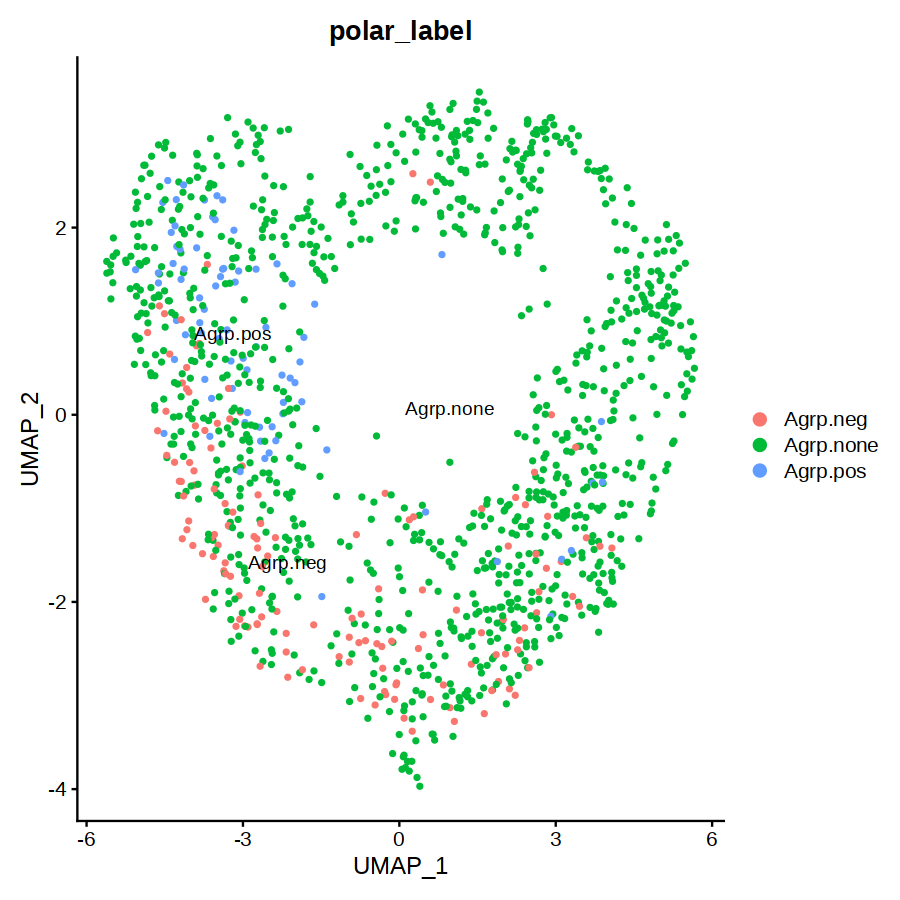

In [103]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [106]:
selected_barcodes = obj %>% subset(subset = labels == 'Unassigned1.sc17.sc28') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k_pre5ea) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 100

Total overdispersed genes: 99

Excluding 1 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 100 by 1117

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 99 genes, 1117 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 1

Calling offset model for all 1 poisson genes

Found 2 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 1 poisson genes by theta=Inf

Setting min_variance based on median UMI:  2.56

Second step: Get residuals using fitted parameters for 100 genes



  |======================================================================| 100%


Computing corrected count matrix for 100 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.625993 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:32:01 UMAP embedding parameters a = 0.9922 b = 1.112

15:32:01 Read 1117 rows and found 30 numeric columns

15:32:01 Using Annoy for neighbor search, n_neighbors = 30

15:32:01 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*


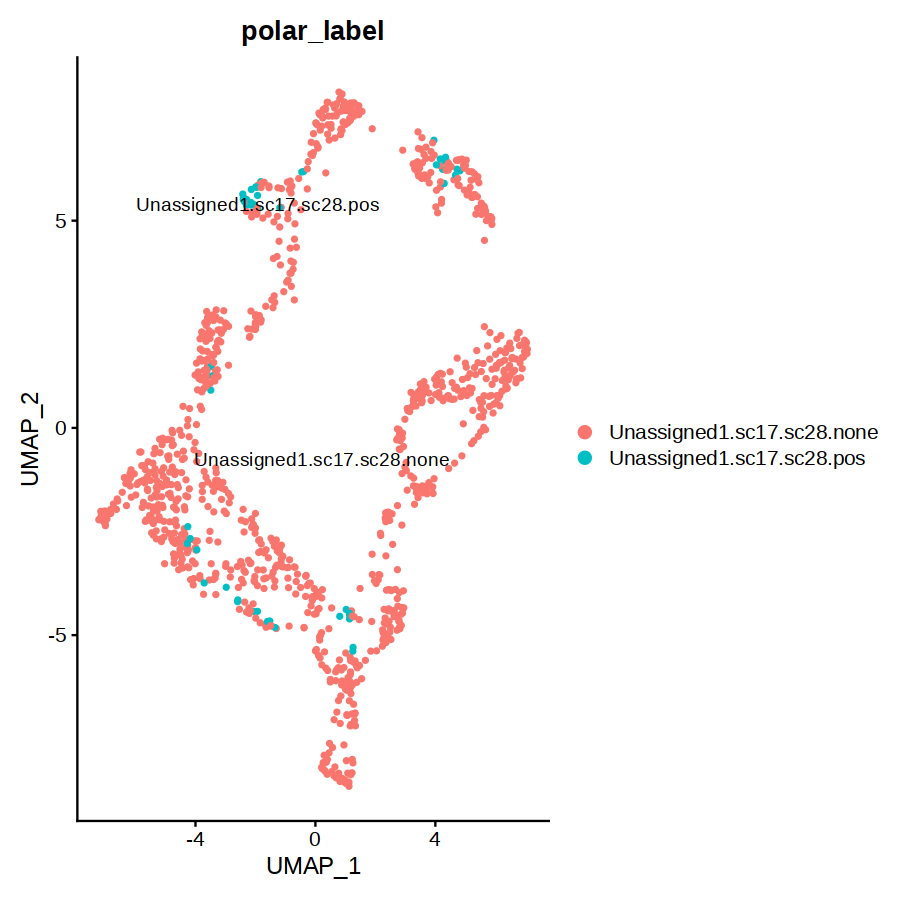

In [107]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [109]:
selected_barcodes = obj %>% subset(subset = labels == 'MOL') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
# subset_seurat_obj_genes(genes_100_all_40k_pre5ea) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 12418

Total overdispersed genes: 10923

Excluding 1495 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 12418 by 1087

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 1087 cells



  |======================================================================| 100%


Setting estimate of  3 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 3

Total # of poisson genes (theta=Inf; variance < mean): 1495

Calling offset model for all 1495 poisson genes

Found 3 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 1495 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.04

Second step: Get residuals using fitted parameters for 12418 genes



  |======================================================================| 100%


Computing corrected count matrix for 12418 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 18.6394 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
15:47:25 UMAP embedding parameters a = 0.9922 b = 1.112

15:47:25 Read 1087 rows and found 30 numeric columns

15:47:25 Using Annoy for neighbor search, n_neighbors = 30

15:47:25 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:47:25 Writing NN index file to temp file /scratch/nmq407/R_tmp//RtmpQwJSkn/filed38f78b01b50

15:47:25 Searching Annoy index using 1 thread, sear

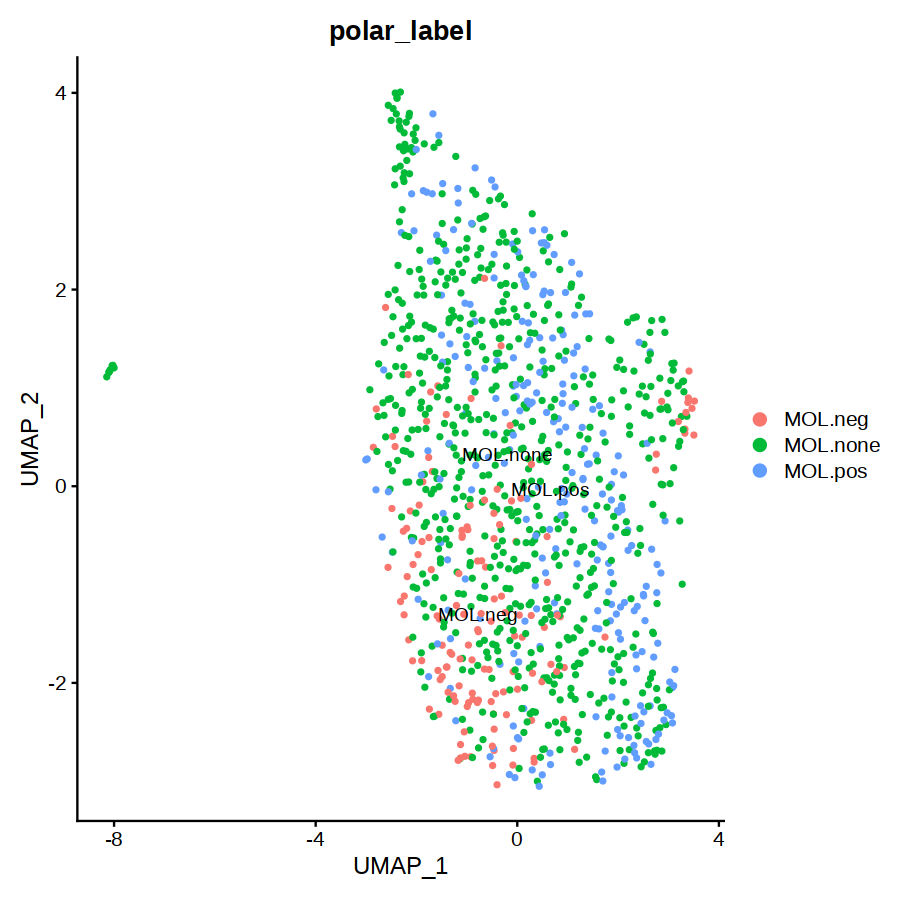

In [110]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [111]:
selected_barcodes = obj %>% subset(subset = labels == 'MOL') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 96

Total overdispersed genes: 94

Excluding 2 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 96 by 1087

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 94 genes, 1087 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 2

Calling offset model for all 2 poisson genes

Ignoring theta inf genes

Replacing fit params for 2 poisson genes by theta=Inf

Setting min_variance based on median UMI:  1.44

Second step: Get residuals using fitted parameters for 96 genes



  |======================================================================| 100%


Computing corrected count matrix for 96 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.657089 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:50:11 UMAP embedding parameters a = 0.9922 b = 1.112

15:50:11 Read 1087 rows and found 30 numeric columns

15:50:11 Using Annoy for neighbor search, n_neighbors = 30

15:50:11 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*


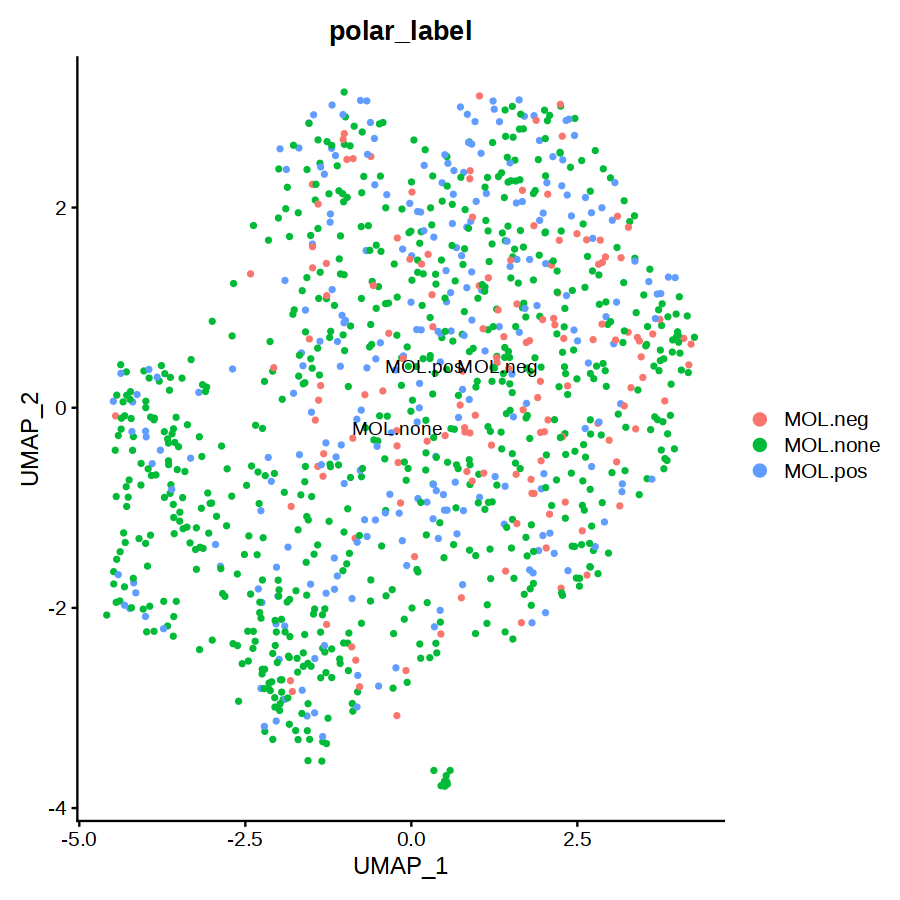

In [112]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [113]:
selected_barcodes = obj %>% subset(subset = labels == 'MOL') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
subset_seurat_obj_genes(genes_100_all_40k_pre5ea) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 98

Total overdispersed genes: 97

Excluding 1 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 98 by 1087

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 97 genes, 1087 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 1

Calling offset model for all 1 poisson genes

Ignoring theta inf genes

Replacing fit params for 1 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.16

Second step: Get residuals using fitted parameters for 98 genes



  |======================================================================| 100%


Computing corrected count matrix for 98 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 2.29384 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
15:50:47 UMAP embedding parameters a = 0.9922 b = 1.112

15:50:47 Read 1087 rows and found 30 numeric columns

15:50:47 Using Annoy for neighbor search, n_neighbors = 30

15:50:47 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

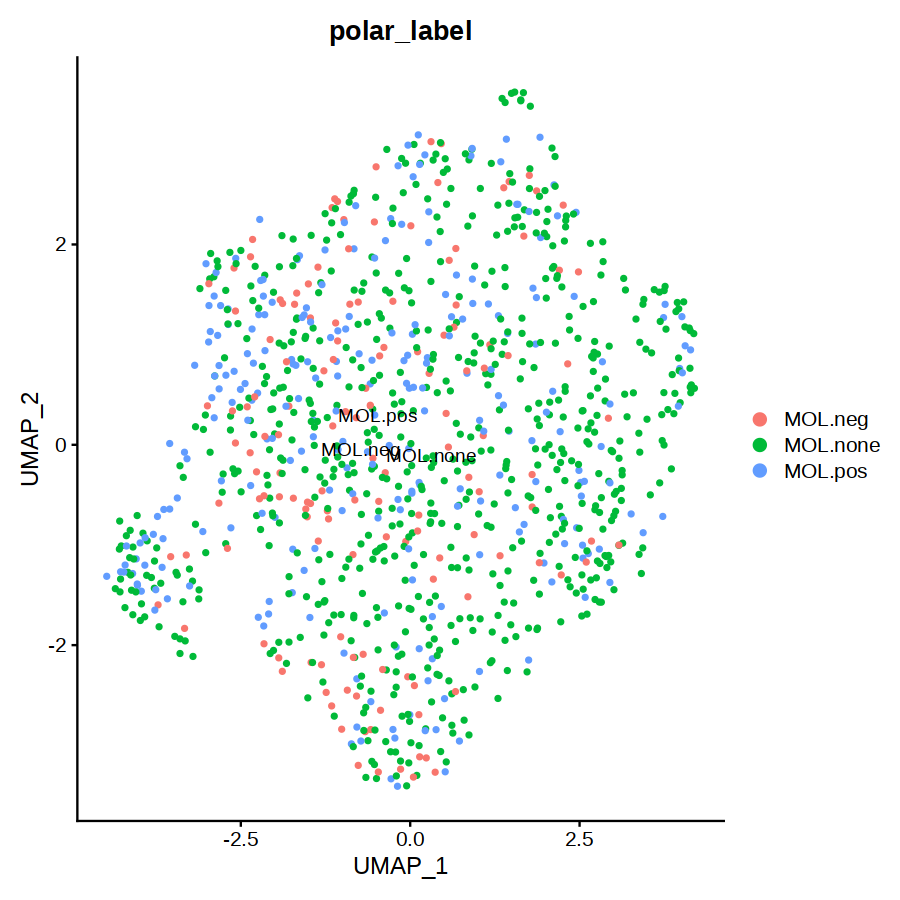

In [114]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [115]:
selected_barcodes = obj %>% subset(subset = labels == 'Htr3b') %>% `[[` %>% rownames
obj_other_100g_MOL = subset(obj, cells = selected_barcodes) %>%
# subset_seurat_obj_genes(genes_100_all_40k_pre5ea) %>% 
sc_transform_fgf1


vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 14382

Total overdispersed genes: 12901

Excluding 1481 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 14382 by 948

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 948 cells



  |======================================================================| 100%


Setting estimate of  2 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 2

Total # of poisson genes (theta=Inf; variance < mean): 1481

Calling offset model for all 1481 poisson genes

Found 4 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 1481 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.16

Second step: Get residuals using fitted parameters for 14382 genes



  |======================================================================| 100%


Computing corrected count matrix for 14382 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 17.54749 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out batch

Centering data matrix

Set default assay to SCT

Warning message:
"Invalid name supplied, making object name syntactically valid. New object name is Seurat..SCTransform.RNA; see ?make.names for more details on syntax validity"
15:54:50 UMAP embedding parameters a = 0.9922 b = 1.112

15:54:50 Read 948 rows and found 30 numeric columns

15:54:50 Using Annoy for neighbor search, n_neighbors = 30

15:54:50 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:54:51 Writing NN index file to temp file /scratch/nmq407/R_tmp//RtmpQwJSkn/filed38f1e1fe6df

15:54:51 Searching Annoy index using 1 thread, sear

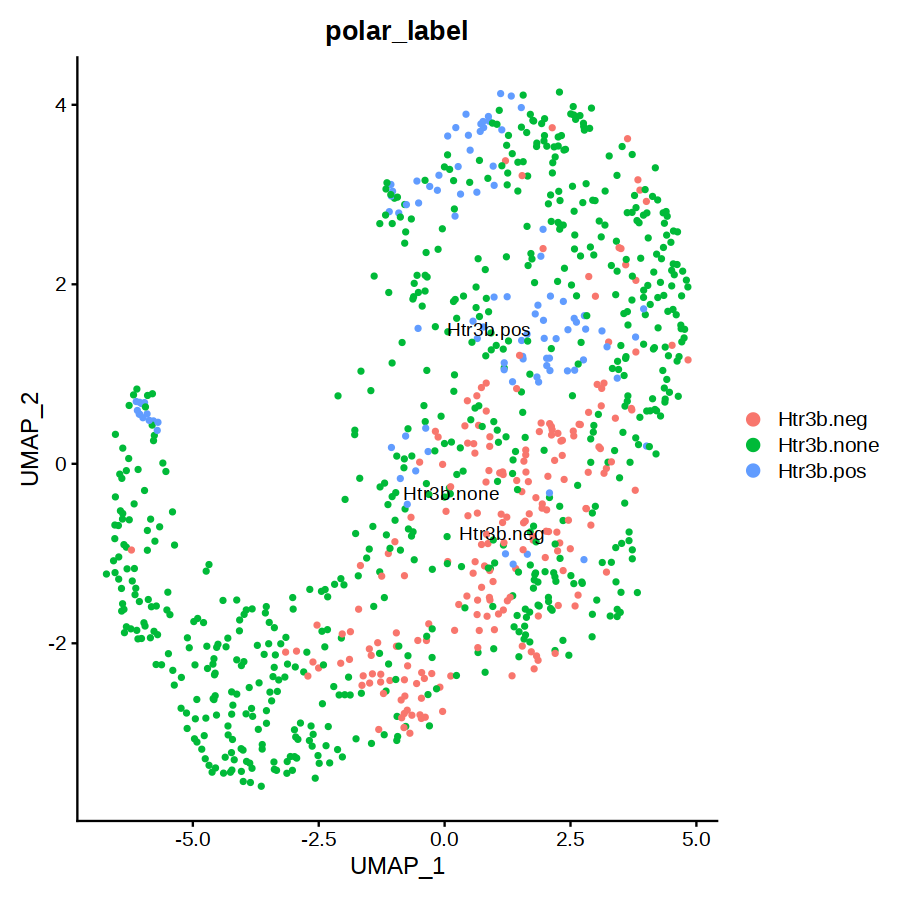

In [116]:
options(repr.plot.width=7.5, repr.plot.height=7.5)
p = DimPlot(obj_other_100g_MOL, reduction = "umap", group.by = "polar_label", label = TRUE)
p

In [131]:
nhood_markers = qs::qread('../01_milo/_targets/objects/nhood_markers_ngo_MOL')
nhood_markers %>% arrange(adj.P.Val_pos) %>% head(10)

,GeneID,logFC_pos,adj.P.Val_pos,logFC_neg,adj.P.Val_neg
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,Zfpm2,0.5696444,7.852216e-06,-0.5666013,0.0009879365
2,Abi1,0.5008606,6.280901e-04,-0.5790884,0.0009508297
3,Pias1,0.5291324,6.280901e-04,-0.6349097,0.0008958525
4,Zfp160,0.3085277,6.280901e-04,-0.3573777,0.0008958525
5,Atp5b,-0.3109981,1.743006e-03,0.3688978,0.0009879365
6,Birc6,-0.4050455,4.346025e-03,0.4921993,0.0012726365
7,Mfn2,-0.2321366,1.020528e-02,0.2641678,0.0068245012
8,Cdc42,-0.4222536,1.101929e-02,0.5274758,0.0015865269
9,Cnot2,-0.2677625,1.101929e-02,0.3541795,0.0008958525


In [128]:
tmd_ngo = qs::qread('../01_milo/_targets/objects/tmd_ngo_MOL')
tmd_ngo

rank,gene,tag
<int>,<chr>,<chr>
1,Zfpm2,MOL
2,Pias1,MOL
3,Zfp160,MOL
4,Abi1,MOL
5,Atp5b,MOL
6,Birc6,MOL
7,Cnot2,MOL
8,Cntn1,MOL
9,Cdc42,MOL


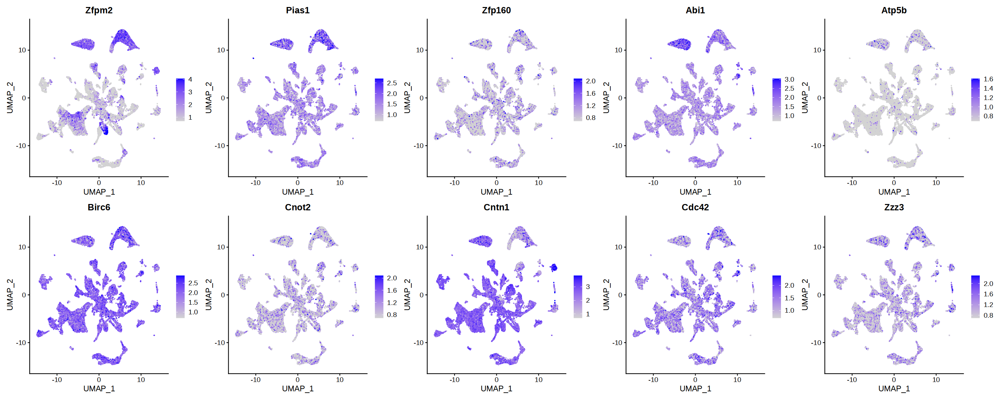

In [135]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99")

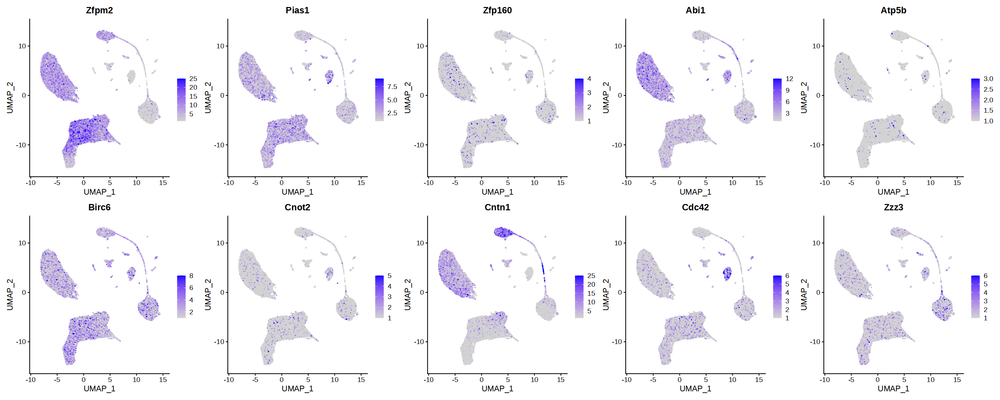

In [139]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj_other, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts")

In [ ]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj_other, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99")

In [140]:
nhood_markers = qs::qread('../01_milo/_targets/objects/nhood_markers_ngo_Htr3b')
nhood_markers %>% arrange(adj.P.Val_pos) %>% head(10)

,GeneID,logFC_pos,adj.P.Val_pos,logFC_neg,adj.P.Val_neg
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,Trpc5,2.5158007,2.865436e-10,-1.9172448,1.434925e-07
2,Syn2,-1.4782096,2.583152e-09,1.0873525,4.557838e-06
3,Cntn3,1.5872648,1.800576e-08,-1.1797315,8.245188e-06
4,Ppargc1a,1.1976398,2.049062e-08,-0.8676626,1.866302e-05
5,Nav1,-1.0396241,1.004172e-06,0.8135996,1.191801e-05
6,Rtl4,2.4839259,1.165090e-06,-1.8540911,6.268623e-05
7,Zfp385a,0.8173881,1.165090e-06,-0.5639305,4.567382e-04
8,Cic,0.6789207,1.679594e-06,-0.4728835,4.994624e-04
9,Iqsec1,-1.0176515,1.679594e-06,0.7695196,6.268623e-05


In [141]:
tmd_ngo = qs::qread('../01_milo/_targets/objects/tmd_ngo_Htr3b')
tmd_ngo

rank,gene,tag
<int>,<chr>,<chr>
1,Trpc5,Htr3b
2,Syn2,Htr3b
3,Cntn3,Htr3b
4,Ppargc1a,Htr3b
5,Nav1,Htr3b
6,Rtl4,Htr3b
7,Fat3,Htr3b
8,Iqsec1,Htr3b
9,Msl1,Htr3b


Warning message in FeaturePlot(obj, features = features, ncol = 5, min.cutoff = "q01", :
"All cells have the same value (1) of Msl1."


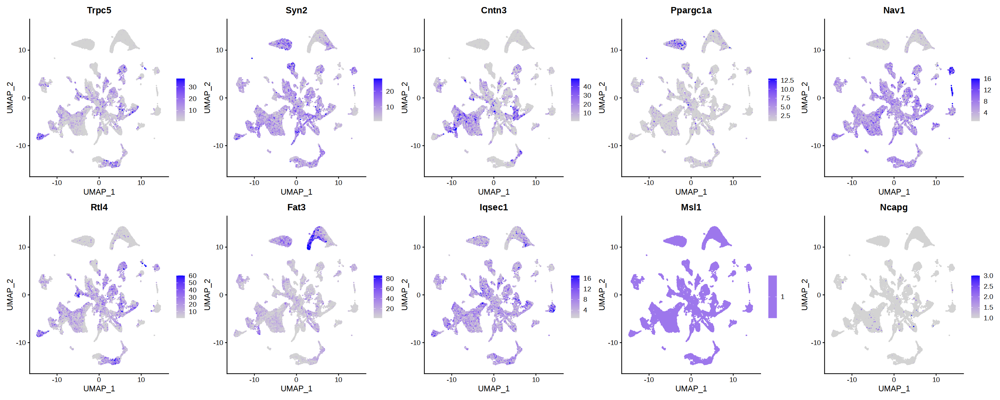

In [142]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts")

Warning message in FeaturePlot(obj_neurons, features = features, ncol = 5, min.cutoff = "q01", :
"All cells have the same value (1) of Msl1."


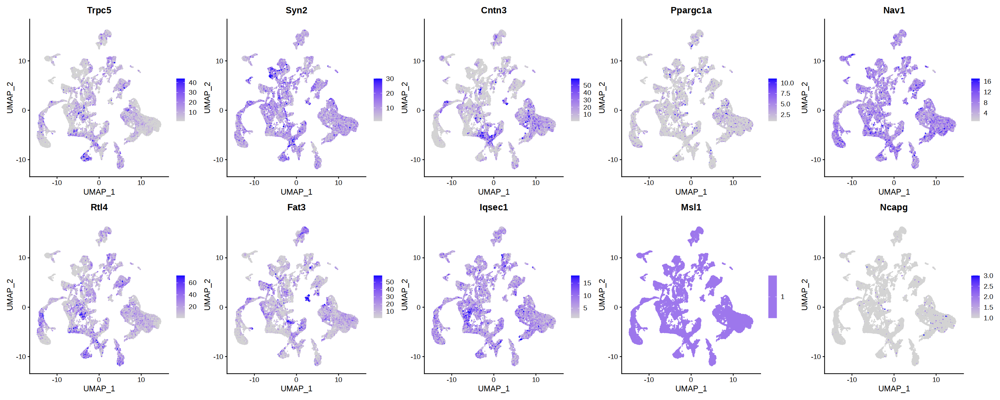

In [144]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj_neurons, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts")

Warning message in FeaturePlot(obj_other_100g_MOL, features = features, ncol = 5, :
"All cells have the same value (1) of Msl1."


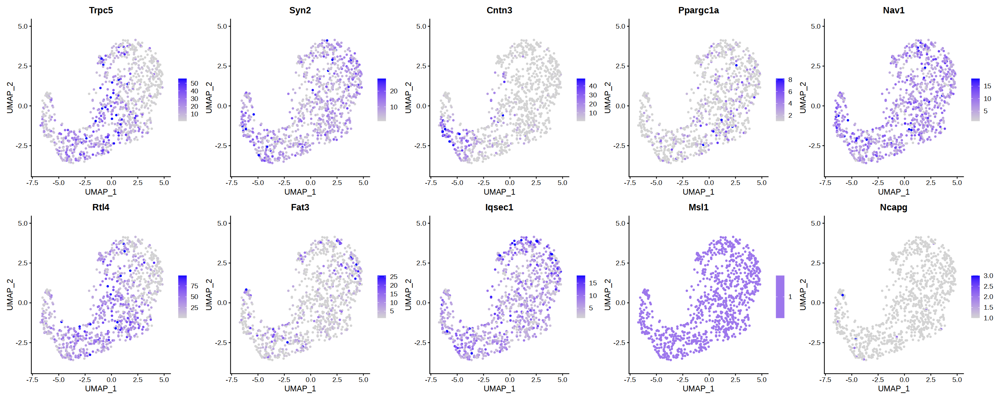

In [147]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj_other_100g_MOL, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
           slot='counts')

In [148]:
nhood_markers = qs::qread('../01_milo/_targets/objects/nhood_markers_ngo_Agrp')
nhood_markers %>% arrange(adj.P.Val_pos) %>% head(10)

,GeneID,logFC_pos,adj.P.Val_pos,logFC_neg,adj.P.Val_neg
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
1,Rab11fip5,0.8517840,9.690844e-10,-0.6968407,1.123947e-06
2,Psmd13,0.6874083,3.185351e-08,-0.5316719,5.021464e-05
3,Tcof1,0.5001639,1.263639e-07,-0.4067057,2.169171e-05
4,Sepsecs,0.5602016,1.866433e-07,-0.3662179,3.562298e-03
5,Ralgapa2,1.0254235,2.387008e-07,-0.7827879,2.061606e-04
6,Tm2d1,0.5992975,4.016546e-07,-0.4225079,1.261986e-03
7,Sympk,-0.5862296,7.758889e-07,0.4783075,5.972249e-05
8,Rab2b,0.6839498,1.128227e-06,-0.5997065,7.378085e-06
9,Sec23b,0.8082709,1.660988e-06,-0.6110550,5.619283e-04


In [149]:
tmd_ngo = qs::qread('../01_milo/_targets/objects/tmd_ngo_Agrp')
tmd_ngo

rank,gene,tag
<int>,<chr>,<chr>
1,Rab11fip5,Agrp
2,Psmd13,Agrp
3,Tcof1,Agrp
4,Rab2b,Agrp
5,Smarcc1,Agrp
6,Sympk,Agrp
7,Ralgapa2,Agrp
8,Dffa,Agrp
9,Msl2,Agrp


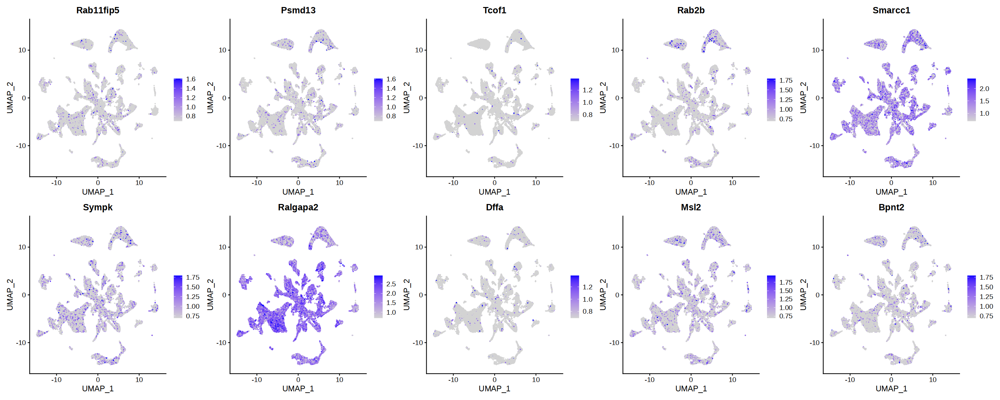

In [150]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99")

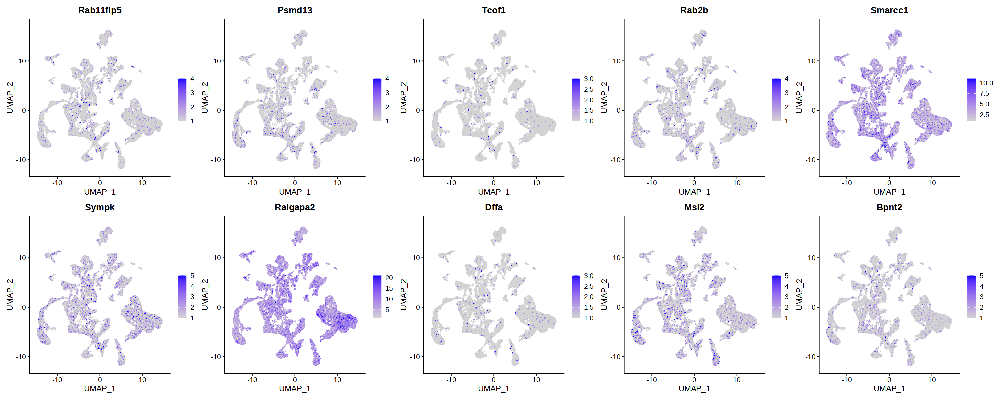

In [151]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=10)
features = tmd_ngo %>% pull(gene)
FeaturePlot(obj_neurons, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts")

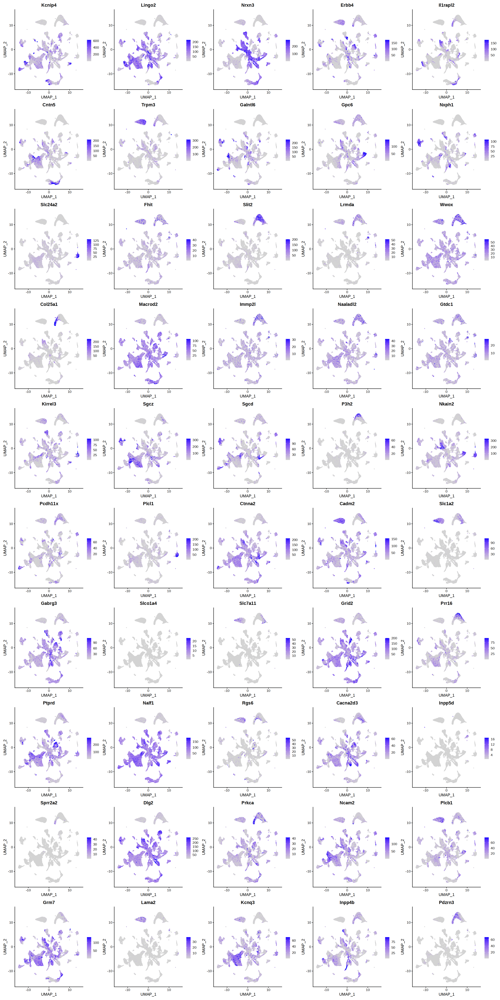

In [165]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=50)
features = genes_100_all_40k_pre5ea[1:50]
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts")

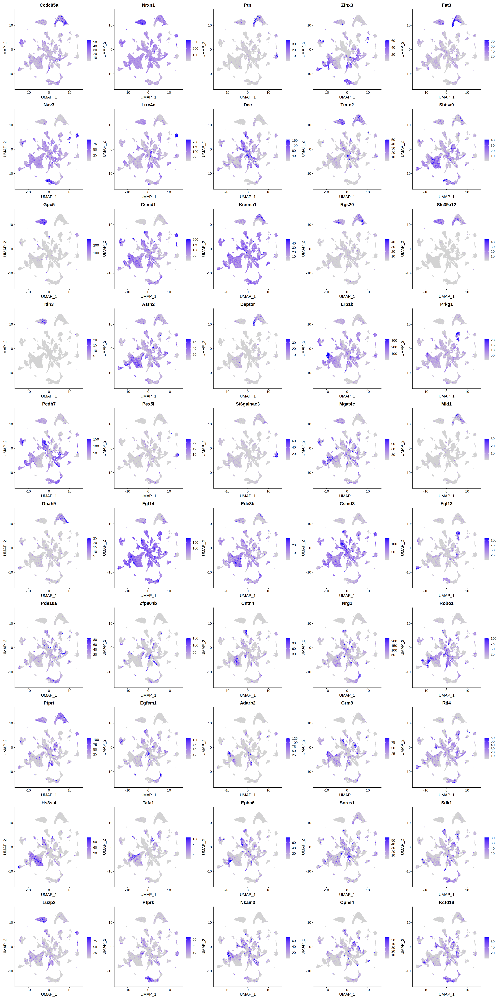

In [166]:
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=25, repr.plot.height=50)
features = genes_100_all_40k_pre5ea[51:100]
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts")

In [2]:
obj = qs::qread('../genebasisr_obob5v5/_targets/objects/exp_all_n2xo')

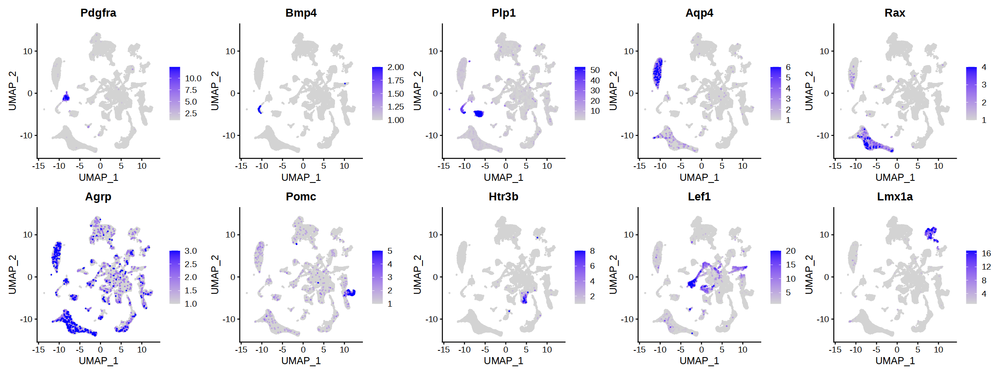

In [5]:
genes_to_plot = c("Pdgfra", # (OPC)
"Bmp4", # (NFOL)
"Plp1", # (MOL)
"Aqp4", # (Astro)
"Rax", # (tany)
"Agrp",
"Pomc",
"Htr3b",
"Lef1",
"Lmx1a") #Unassigned1

DefaultAssay(obj) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=20, repr.plot.height=7.5)
features = genes_to_plot
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)

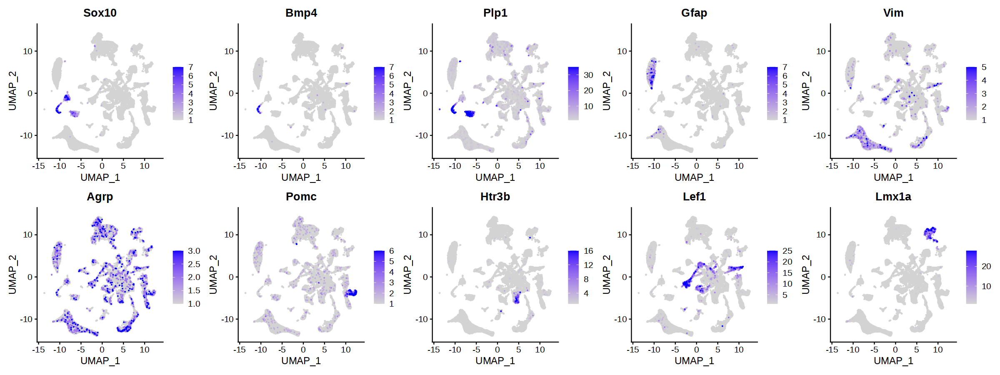

In [17]:
genes_to_plot = c("Sox10", # (OPC)
"Bmp4", # (NFOL)
"Plp1", # (MOL)
"Gfap", # (Astro)
"Vim", # (tany)
"Agrp",
"Pomc",
"Htr3b",
"Lef1",
"Lmx1a") #Unassigned1

DefaultAssay(obj) = "RNA"
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=20, repr.plot.height=7.5)
features = genes_to_plot
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)

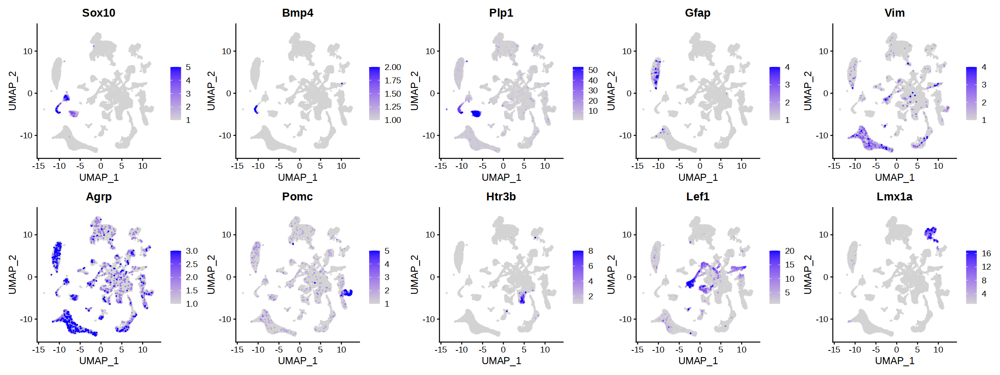

In [18]:
genes_to_plot = c("Sox10", # (OPC)
"Bmp4", # (NFOL)
"Plp1", # (MOL)
"Gfap", # (Astro)
"Vim", # (tany)
"Agrp",
"Pomc",
"Htr3b",
"Lef1",
"Lmx1a") #Unassigned1

DefaultAssay(obj) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=20, repr.plot.height=7.5)
features = genes_to_plot
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)

In [1]:
genes_to_plot = c("Sox10", # (OPC)
"Bmp4", # (NFOL)
"Plp1", # (MOL)
"Gfap", # (Astro)
"Rax", # (tany)
"Agrp",
"Pomc",
"Htr3b",
"Lef1",
"Lmx1a") #Unassigned1

DefaultAssay(obj) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=20, repr.plot.height=7.5)
features = genes_to_plot
FeaturePlot(obj, features = features, 
            ncol = 5,
#             min.cutoff="q01",
#             max.cutoff="q99",
            slot="counts", 
            order=TRUE)

ERROR: Error in DefaultAssay(obj) = "SCT": object 'obj' not found


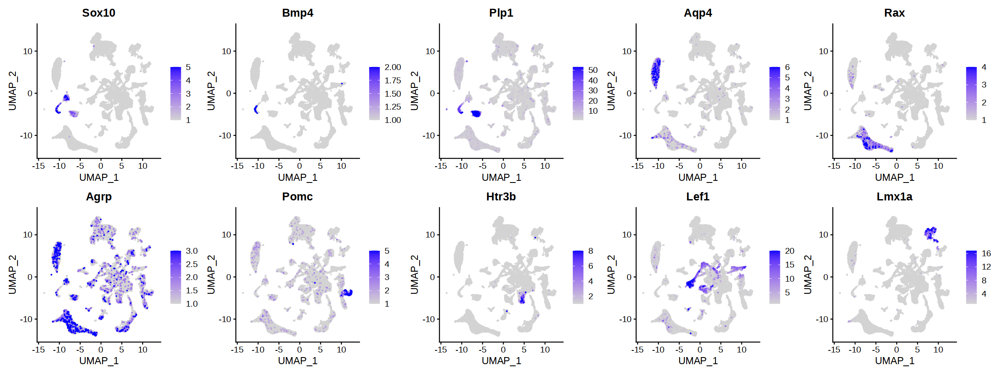

In [20]:
genes_to_plot = c("Sox10", # (OPC)
"Bmp4", # (NFOL)
"Plp1", # (MOL)
"Aqp4", # (Astro)
"Rax", # (tany)
"Agrp",
"Pomc",
"Htr3b",
"Lef1",
"Lmx1a") #Unassigned1

DefaultAssay(obj) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=20, repr.plot.height=7.5)
features = genes_to_plot
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)

In [ ]:
genes_to_plot = c("Sox10", # (OPC)
"Bmp4", # (NFOL)
"Plp1", # (MOL)
"Aqp4", # (Astro)
"Rax", # (tany)
"Agrp",
"Pomc",
"Htr3b",
"Trh",
"Lmx1a") #Unassigned1

DefaultAssay(obj) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=20, repr.plot.height=7.5)
features = genes_to_plot
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)

Warning message in FeaturePlot(obj, features = features, ncol = 5, min.cutoff = "q01", :
“All cells have the same value (1) of Trh.”


In [ ]:
genes_to_plot = c("Sox10", # (OPC)
"Bmp4", # (NFOL)
"Plp1", # (MOL)
"Aqp4", # (Astro)
"Rax", # (tany)
"Agrp",
"Pomc",
"Htr3b",
"Lef1",
"Lmx1a") #Unassigned1

DefaultAssay(obj) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
options(repr.plot.width=20, repr.plot.height=7.5)
features = genes_to_plot
FeaturePlot(obj, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)

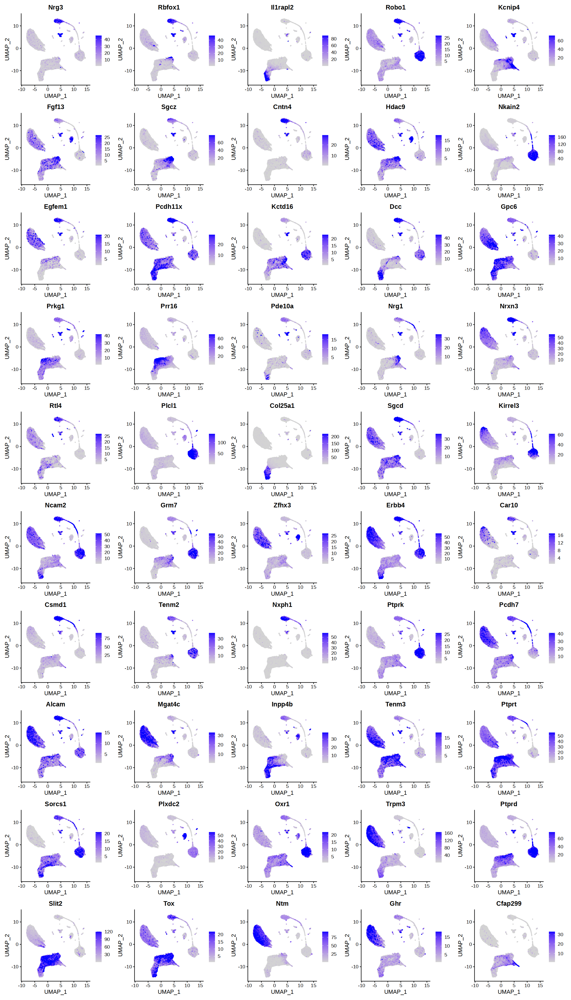

In [4]:
DefaultAssay(obj_other) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
features = c("Nrg3", "Rbfox1", "Il1rapl2", "Robo1", "Kcnip4", "Fgf13", "Sgcz", 
"Cntn4", "Hdac9", "Nkain2", "Egfem1", "Pcdh11x", "Kctd16", "Dcc", 
"Gpc6", "Prkg1", "Prr16", "Pde10a", "Nrg1", "Nrxn3", "Rtl4", 
"Plcl1", "Col25a1", "Sgcd", "Kirrel3", "Ncam2", "Grm7", "Zfhx3", 
"Erbb4", "Car10", "Csmd1", "Tenm2", "Nxph1", "Ptprk", "Pcdh7", 
"Alcam", "Mgat4c", "Inpp4b", "Tenm3", "Ptprt", "Sorcs1", "Plxdc2", 
"Oxr1", "Trpm3", "Ptprd", "Slit2", "Tox", "Ntm", "Ghr", "Cfap299"
)
options(repr.plot.width=20, repr.plot.height=35)
FeaturePlot(obj_other, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)

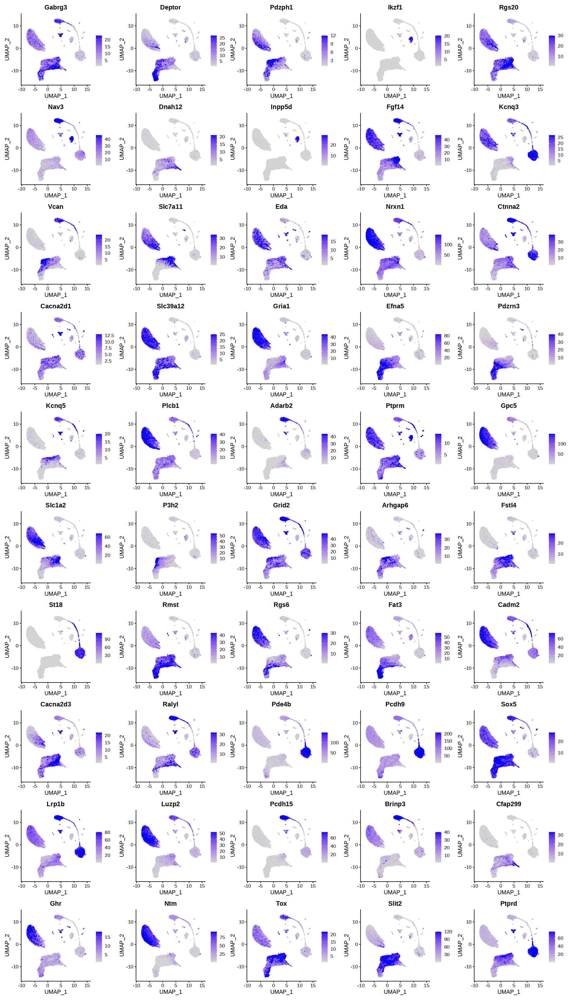

In [5]:
DefaultAssay(obj_other) = "SCT"
# Feature plot - visualize feature expression in low-dimensional space
features = c("Gabrg3", "Deptor", "Pdzph1", "Ikzf1", "Rgs20", "Nav3", "Dnah12", 
"Inpp5d", "Fgf14", "Kcnq3", "Vcan", "Slc7a11", "Eda", "Nrxn1", 
"Ctnna2", "Cacna2d1", "Slc39a12", "Gria1", "Efna5", "Pdzrn3", 
"Kcnq5", "Plcb1", "Adarb2", "Ptprm", "Gpc5", "Slc1a2", "P3h2", 
"Grid2", "Arhgap6", "Fstl4", "St18", "Rmst", "Rgs6", "Fat3", 
"Cadm2", "Cacna2d3", "Ralyl", "Pde4b", "Pcdh9", "Sox5", "Lrp1b", 
"Luzp2", "Pcdh15", "Brinp3", "Cfap299", "Ghr", "Ntm", "Tox", 
"Slit2", "Ptprd")
options(repr.plot.width=20, repr.plot.height=35)
FeaturePlot(obj_other, features = features, 
            ncol = 5,
            min.cutoff="q01",
            max.cutoff="q99",
            slot="counts", 
            order=TRUE)